In [1]:
import librosa
import librosa.display
import IPython.display
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline

In [2]:
import scipy.ndimage.morphology

struct = np.ones((7,7))

In [3]:
def var_trust_func(Y, numFrames=200):
    x = int(Y.shape[1]/numFrames)
    var_trust = np.ones(Y.shape)
    
    for i in range(0, Y.shape[1], numFrames):
        indice_start = i
        indice_stop = indice_start+numFrames

        Y_p = Y[:,indice_start:indice_stop]
        var_p = np.sqrt(Y_p.var(1))
        var_p = var_p.reshape(var_p.shape[0],1)   
        var_trust[:,indice_start:indice_stop] = var_p
        
    var_trust = var_trust / np.max(var_trust)
    return(var_trust)

def expand_contrast(contrast_p, shape, n_bands, deltaF):
    contrast = np.ones(shape)
    for i in range(0, n_bands+1):        
        if i == 0:
            indice_start = 0
        else:
            indice_start = deltaF * 2**(i-1)
        
        indice_stop = deltaF * 2**i - 1
        contrast[indice_start:indice_stop,:] = contrast_p[i,:]

    contrast[indice_stop+1:,:] = contrast_p[n_bands,:]    
    return(contrast)

# Retorna a máscara relativa ao contraste
def contrast_trust_func(Y, sr):
    n_bands = 8
    contrast_p = librosa.feature.spectral_contrast(S=Y, sr=sr, linear=True, n_bands=n_bands, fmin=64)
    deltaF = int(round(64/(sr/(2*Y.shape[0]))))
    contrast = expand_contrast(contrast_p, Y.shape, n_bands, deltaF)
    contrast /= np.max(contrast)
    return(contrast)

In [4]:
def my_filter(y, sr):
    
    Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
    Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
       
    var_trust = var_trust_func(Y_dB)
    contrast = contrast_trust_func(np.abs(Y), sr)
    
    mask = np.zeros(var_trust.shape)
    mask[np.logical_and(var_trust > 0.8, contrast > 0.2)] = 1
    mask = scipy.ndimage.morphology.binary_dilation(mask, struct)
    
    mag, phase = librosa.magphase(Y)
    newmag = np.multiply(mag, mask)
    Y_rec = np.multiply(newmag, np.exp(np.multiply(phase, (1j))))
    
    y_rec = librosa.istft(Y_rec, hop_length=512)
    return y_rec, Y_rec

In [10]:
def my_filter_dilated(y, sr, percentile):
    
    Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
    Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
       
    var_trust = var_trust_func(Y_dB)
    contrast = contrast_trust_func(np.abs(Y), sr)
    
    threshold_var = np.percentile(var_trust, percentile)
    threshold_contrast = np.percentile(contrast, percentile)
    
    mask = np.zeros(var_trust.shape)
    mask[np.logical_and(var_trust > threshold_var, contrast > threshold_contrast)] = 1
    mask = scipy.ndimage.morphology.binary_dilation(mask, struct)

    
    mag, phase = librosa.magphase(Y)
    newmag = np.multiply(mag, mask)
    Y_rec = np.multiply(newmag, np.exp(np.multiply(phase, (1j))))
    
    y_rec = librosa.istft(Y_rec, hop_length=512)
   
    return y_rec, Y_rec

## Áudio #1 

In [11]:
y, sr = librosa.load("../../audio/whittakeri.wav", sr=44100)
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)

In [18]:
ys, Ys = my_filter(y,sr)

In [19]:
y_dil, Y_dil = my_filter_dilated(y, sr, 95)

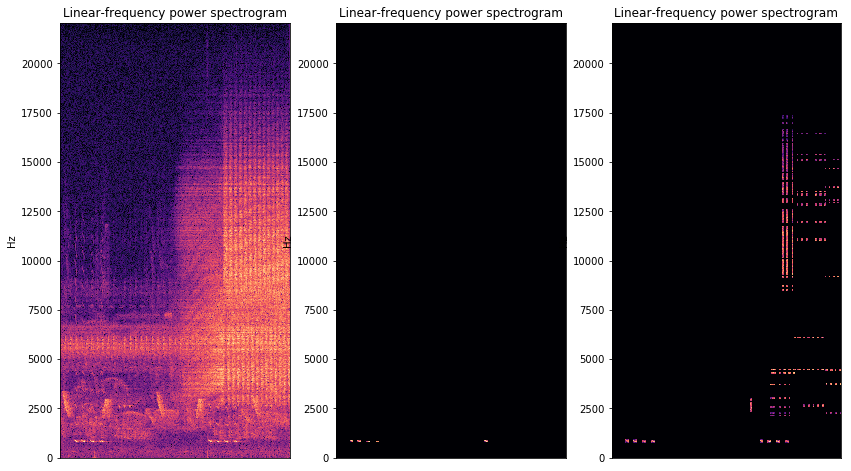

In [20]:
plt.figure(figsize=(14,8))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [27]:
IPython.display.Audio(data=ys, rate=sr)

In [28]:
IPython.display.Audio(data=y, rate=sr)

## Áudio #2 

In [21]:
y, sr = librosa.load("../../audio/48054_44k.wav", sr=44100)

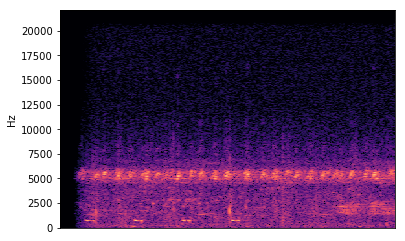

In [22]:
y = y[44100*4:44100*10]
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)

In [23]:
ys, Ys, = my_filter(y,sr)

In [26]:
y_dil, Y_dil = my_filter_dilated(y, sr, 95)

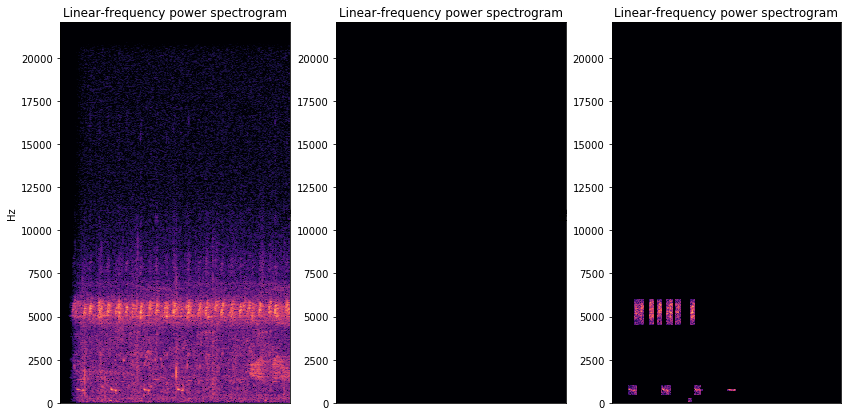

In [27]:
plt.figure(figsize=(14,7))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [44]:
IPython.display.Audio(data=y, rate=sr)

In [45]:
IPython.display.Audio(data=ys, rate=sr)

In [46]:
IPython.display.Audio(data=y_dil, rate=sr)

## Áudio #3

In [28]:
y, sr = librosa.load("../../audio/48137_44k.wav", sr=44100)

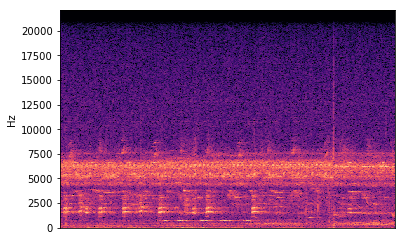

In [29]:
y = y[44100*10:44100*20]
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)

In [30]:
ys, Ys = my_filter(y,sr)
y_dil, Y_dil = my_filter_dilated(y, sr, 95)

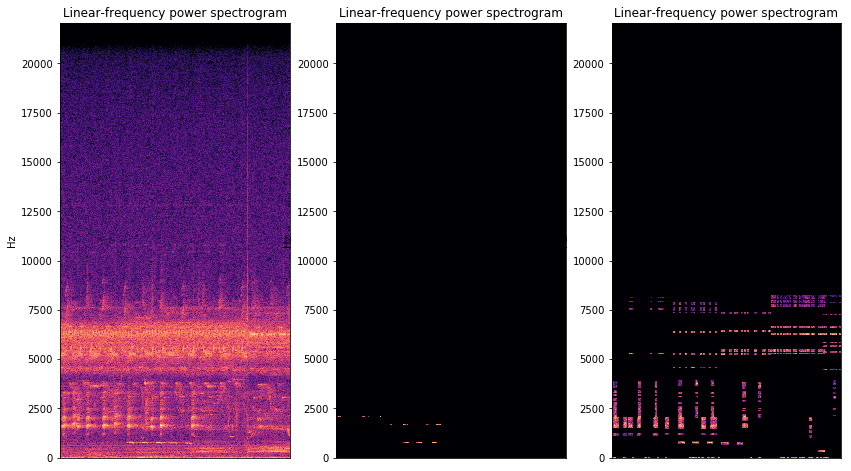

In [31]:
plt.figure(figsize=(14,8))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [17]:
IPython.display.Audio(data=y, rate=sr)

In [18]:
IPython.display.Audio(data=ys, rate=sr)

In [19]:
IPython.display.Audio(data=y_dil, rate=sr)

## Áudio #4

In [32]:
y, sr = librosa.load("../../audio/48138_44k.wav", sr=44100)

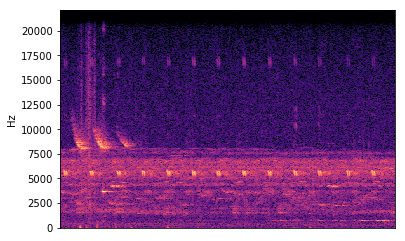

In [33]:
y = y[44100*10:44100*20]
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)

In [34]:
ys, Ys = my_filter(y,sr)

In [23]:
y_dil, Y_dil = my_filter_dilated(y,sr, 95)

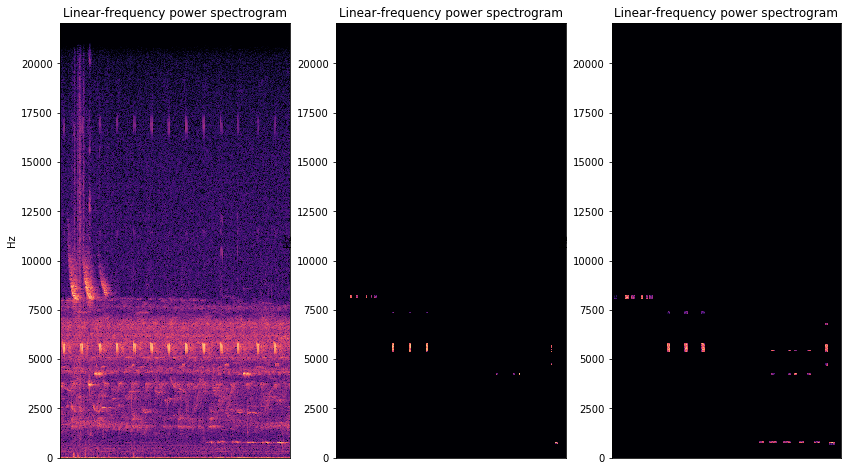

In [24]:
plt.figure(figsize=(14,8))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [25]:
IPython.display.Audio(data=y, rate=sr)

In [26]:
IPython.display.Audio(data=ys, rate=sr)

In [27]:
IPython.display.Audio(data=y_dil, rate=sr)

## Áudio #5 

In [28]:
y, sr = librosa.load("../../audio/74395_44k.wav", sr=44100)

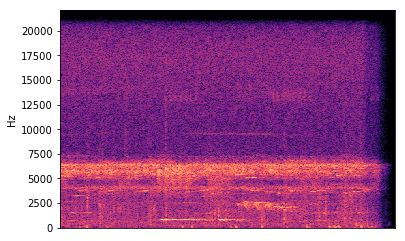

In [29]:
y = y[44100*5:44100*15]
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)

In [30]:
ys, Ys = my_filter(y,sr)

In [31]:
y_dil, Y_dil = my_filter_dilated(y, sr)

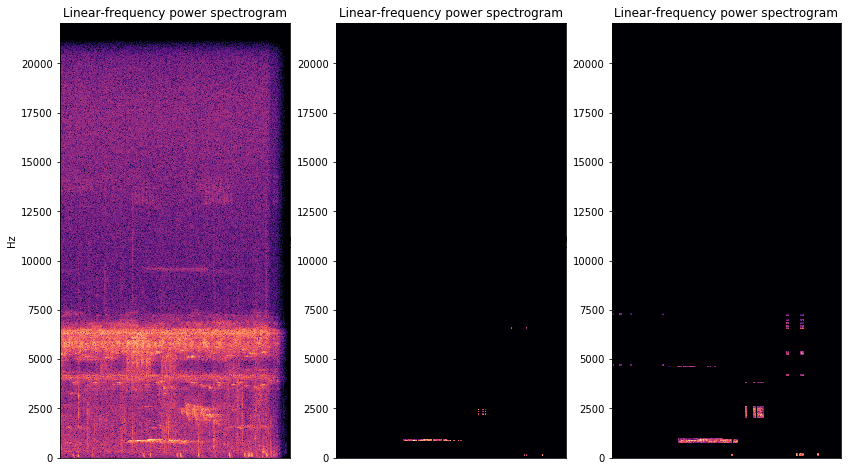

In [32]:
plt.figure(figsize=(14,8))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [33]:
IPython.display.Audio(data=y, rate=sr)

In [34]:
IPython.display.Audio(data=ys, rate=sr)

In [35]:
IPython.display.Audio(data=y_dil, rate=sr)

## Áudio #6 

In [38]:
y, sr = librosa.load("../../audio/106054_44k.wav", sr=44100)

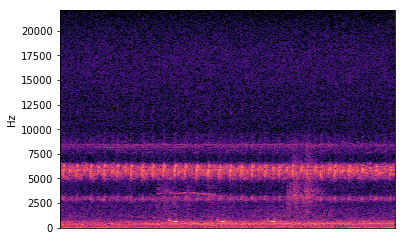

In [39]:
y = y[44100*7:44100*15]
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)

In [40]:
ys, Ys = my_filter(y,sr)

In [41]:
y_dil, Y_dil = my_filter_dilated(y,sr)

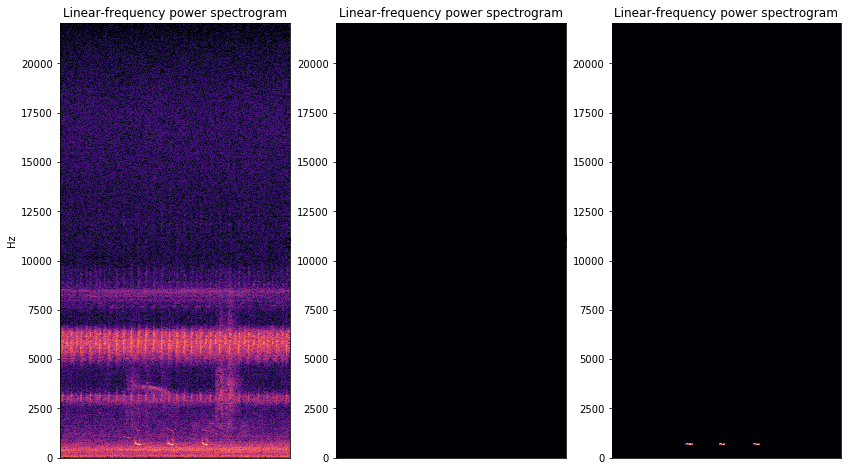

In [42]:
plt.figure(figsize=(14,8))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [43]:
IPython.display.Audio(data=y, rate=sr)

In [44]:
IPython.display.Audio(data=ys, rate=sr)

In [45]:
IPython.display.Audio(data=y_dil, rate=sr)

## Novos áudios

In [16]:
y, sr = librosa.load("../../audio/berlepschi.wav", sr=44100)

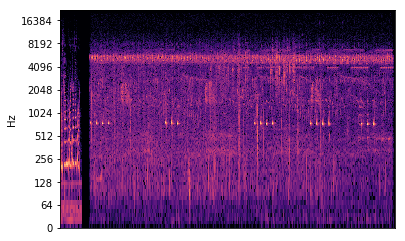

In [17]:
Y = librosa.stft(y, n_fft = 4096, hop_length = 512)
Y_dB = librosa.amplitude_to_db(Y, ref=np.max)
librosa.display.specshow(Y_dB, y_axis='log', sr=sr, hop_length = 512)

In [18]:
ys, Ys = my_filter(y,sr)

In [19]:
y_dil, Y_dil = my_filter_dilated(y,sr, 95)

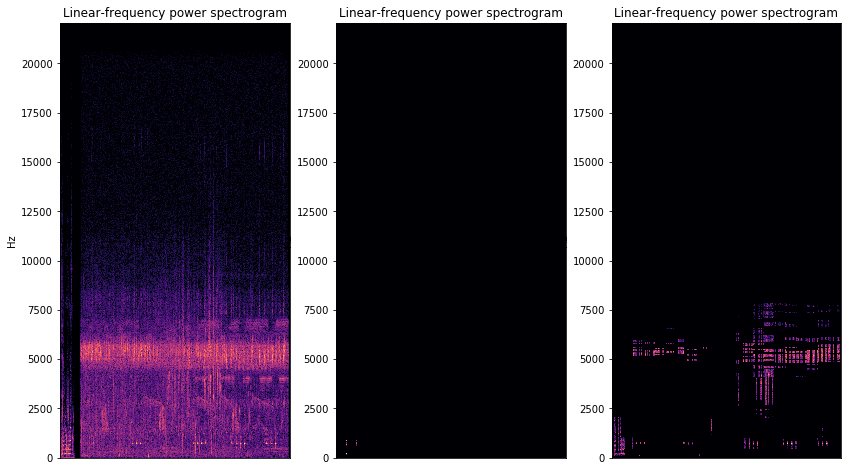

In [20]:
plt.figure(figsize=(14,8))
plt.subplot(1,3,1)
librosa.display.specshow(Y_dB, y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,2)
librosa.display.specshow(librosa.amplitude_to_db(Ys, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

plt.subplot(1,3,3)
librosa.display.specshow(librosa.amplitude_to_db(Y_dil, np.max), y_axis='linear', sr=sr, hop_length = 512)
#plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

In [21]:
IPython.display.Audio(data=y, rate=sr)

In [22]:
IPython.display.Audio(data=ys, rate=sr)

In [23]:
IPython.display.Audio(data=y_dil, rate=sr)